In [142]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import MarkerCluster
from sklearn.preprocessing import MinMaxScaler

In [143]:
#Load the data
df = pd.read_csv('kc_house_data.csv')

In [144]:
#Check the first 5 rows of the dataframe
print(df.head().transpose())

                             0                1                2  \
id                  7129300520       6414100192       5631500400   
date           20141013T000000  20141209T000000  20150225T000000   
price                 221900.0         538000.0         180000.0   
bedrooms                     3                3                2   
bathrooms                  1.0             2.25              1.0   
sqft_living               1180             2570              770   
sqft_lot                  5650             7242            10000   
floors                     1.0              2.0              1.0   
waterfront                   0                0                0   
view                         0                0                0   
condition                    3                3                3   
grade                        7                7                6   
sqft_above                1180             2170              770   
sqft_basement                0              400 

In [145]:
#Check the data types of the columns
print(df.dtypes)

id                 int64
date              object
price            float64
bedrooms           int64
bathrooms        float64
sqft_living        int64
sqft_lot           int64
floors           float64
waterfront         int64
view               int64
condition          int64
grade              int64
sqft_above         int64
sqft_basement      int64
yr_built           int64
yr_renovated       int64
zipcode            int64
lat              float64
long             float64
sqft_living15      int64
sqft_lot15         int64
dtype: object


In [146]:
#Check the number of samples and features
print(df.shape)

(21613, 21)


In [147]:
print(df.describe())

                 id         price      bedrooms     bathrooms   sqft_living  \
count  2.161300e+04  2.161300e+04  21613.000000  21613.000000  21613.000000   
mean   4.580302e+09  5.400881e+05      3.370842      2.114757   2079.899736   
std    2.876566e+09  3.671272e+05      0.930062      0.770163    918.440897   
min    1.000102e+06  7.500000e+04      0.000000      0.000000    290.000000   
25%    2.123049e+09  3.219500e+05      3.000000      1.750000   1427.000000   
50%    3.904930e+09  4.500000e+05      3.000000      2.250000   1910.000000   
75%    7.308900e+09  6.450000e+05      4.000000      2.500000   2550.000000   
max    9.900000e+09  7.700000e+06     33.000000      8.000000  13540.000000   

           sqft_lot        floors    waterfront          view     condition  \
count  2.161300e+04  21613.000000  21613.000000  21613.000000  21613.000000   
mean   1.510697e+04      1.494309      0.007542      0.234303      3.409430   
std    4.142051e+04      0.539989      0.086517    

In [148]:
#Check for missing values
print(df.isnull().sum())

id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64


In [149]:
#Check for duplicates
print(df.duplicated().sum())

0


In [150]:
#Check for unique values in the columns
print(df.nunique())

id               21436
date               372
price             4028
bedrooms            13
bathrooms           30
sqft_living       1038
sqft_lot          9782
floors               6
waterfront           2
view                 5
condition            5
grade               12
sqft_above         946
sqft_basement      306
yr_built           116
yr_renovated        70
zipcode             70
lat               5034
long               752
sqft_living15      777
sqft_lot15        8689
dtype: int64


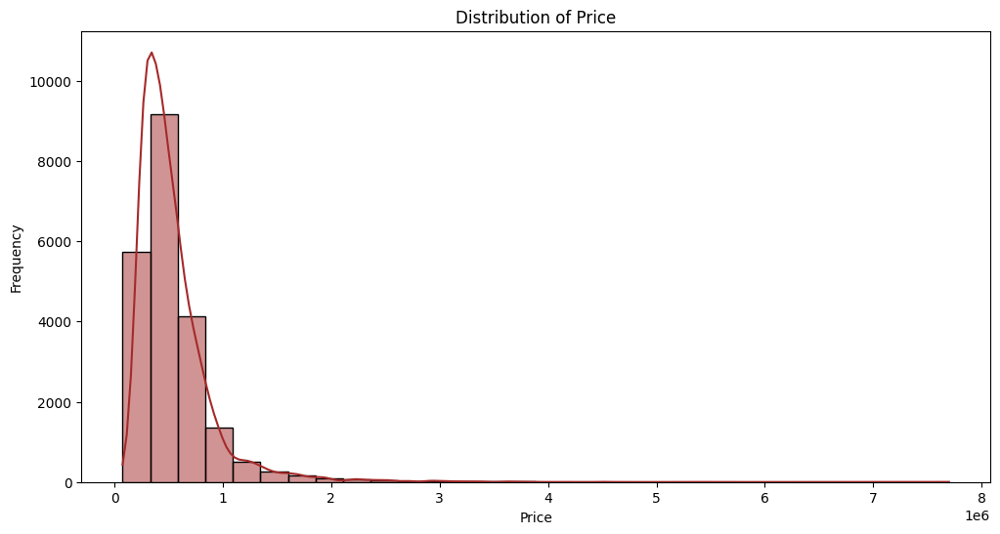

In [151]:
#Distribution of the target variable
plt.figure(figsize=(12,6))
sns.histplot(df['price'], kde=True, bins=30, color='brown')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.title('Distribution of Price')
plt.show()

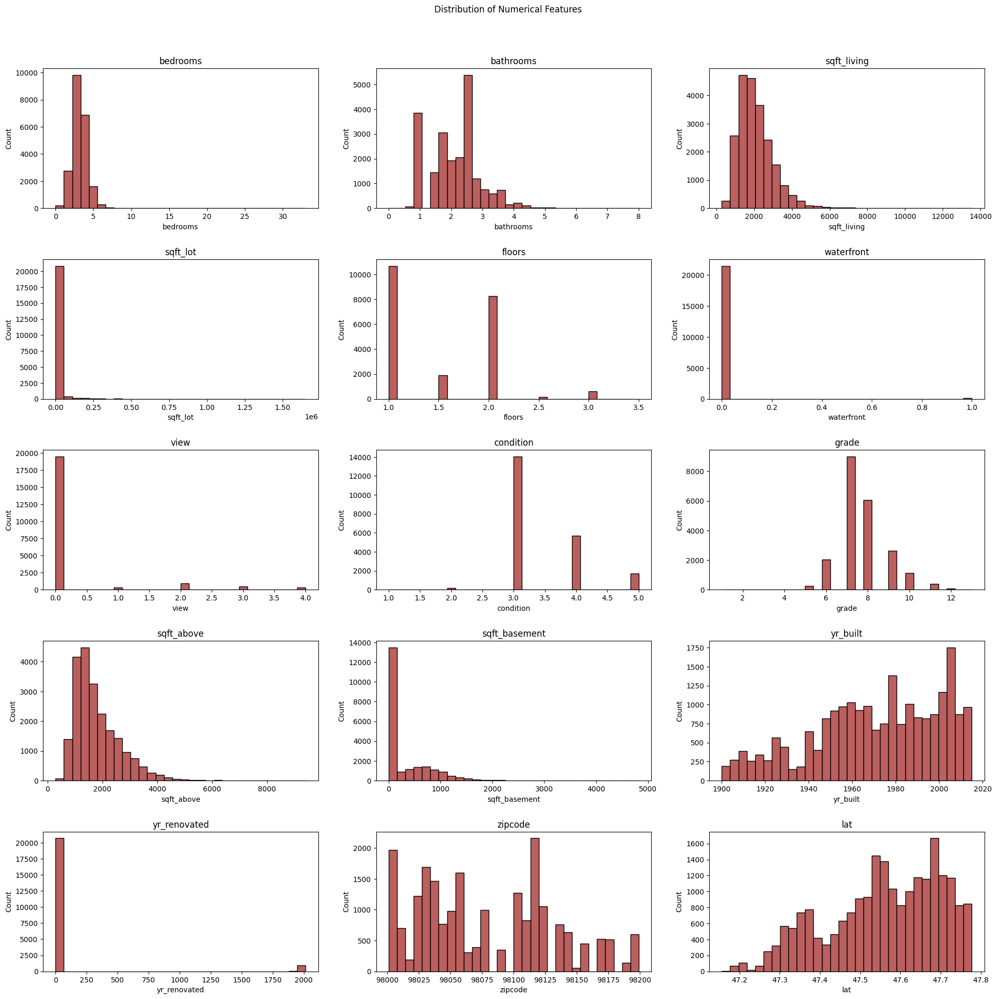

In [152]:
#Distribution of numerical features without the target variable and id
numerical_features = df.select_dtypes(include=[np.number]).columns.tolist()
numerical_features.remove('id')
numerical_features.remove('price')

fig, axes = plt.subplots(5, 3, figsize=(20, 20))
fig.suptitle('Distribution of Numerical Features')
fig.tight_layout(pad=5.0)

for i, ax in enumerate(fig.axes):
    if i < len(numerical_features):
        ax.set_title(numerical_features[i])
        sns.histplot(df[numerical_features[i]], bins=30, color='brown', ax=ax)

plt.show()

In [153]:
#Remove id and date columns
df = df.drop(['id'], axis=1)

In [154]:
df_numeral = df.select_dtypes(include=[np.number])

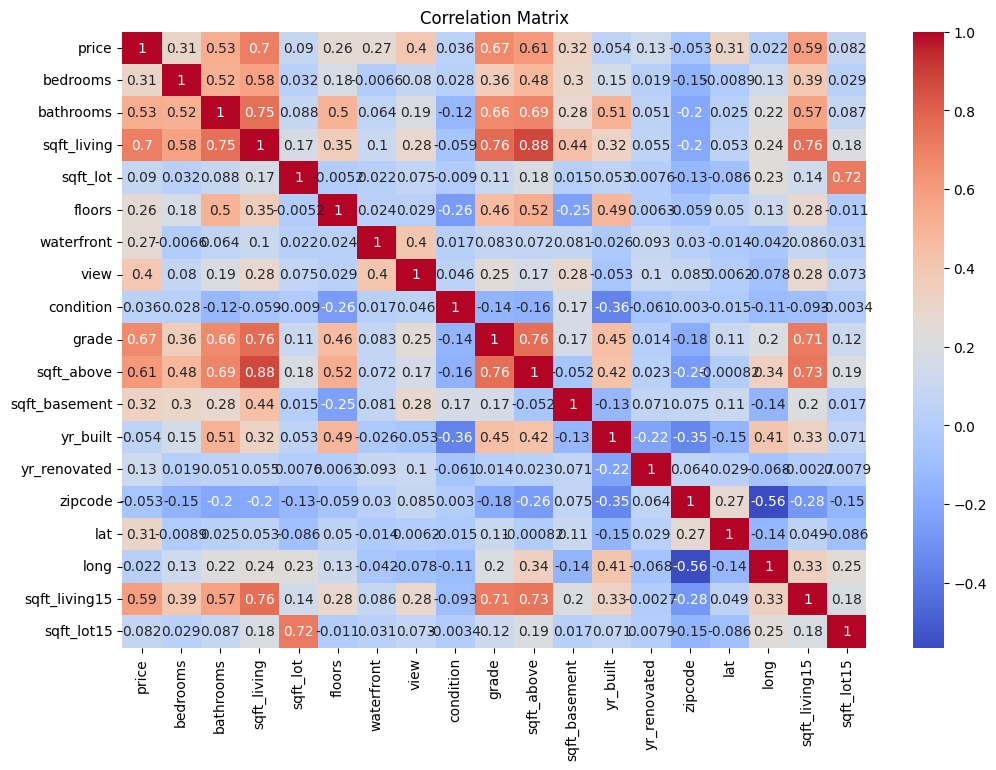

In [155]:
#Correlation matrix
correlation_matrix = df_numeral.corr()
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()


In [156]:
#Correlation of the features with the target variable
correlation_with_target = df_numeral.corr()['price'].sort_values(ascending=False)
print(correlation_with_target)

price            1.000000
sqft_living      0.702035
grade            0.667434
sqft_above       0.605567
sqft_living15    0.585379
bathrooms        0.525138
view             0.397293
sqft_basement    0.323816
bedrooms         0.308350
lat              0.307003
waterfront       0.266369
floors           0.256794
yr_renovated     0.126434
sqft_lot         0.089661
sqft_lot15       0.082447
yr_built         0.054012
condition        0.036362
long             0.021626
zipcode         -0.053203
Name: price, dtype: float64


In [157]:
#Remove the features with low correlation with the target variable
df = df.drop('zipcode', axis=1)

In [158]:
numerical_features.remove('zipcode')
df_numeral = df_numeral.drop('zipcode', axis=1)

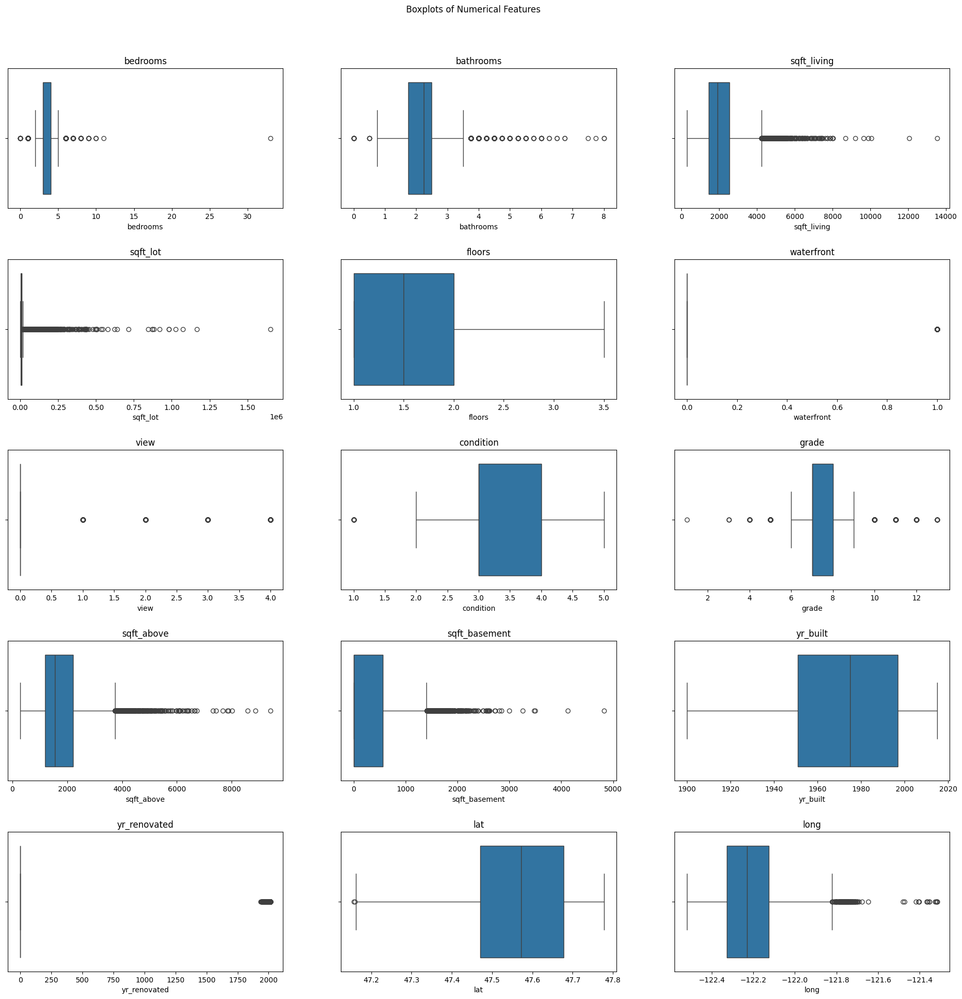

In [159]:
#Check for outliers
fig, axes = plt.subplots(5, 3, figsize=(20, 20))
fig.suptitle('Boxplots of Numerical Features')
fig.tight_layout(pad=5.0)

for i, ax in enumerate(fig.axes):
    if i < len(numerical_features):
        ax.set_title(numerical_features[i])
        sns.boxplot(x=df[numerical_features[i]], ax=ax)

plt.show()

In [160]:
#Time analysis
df['date'] = pd.to_datetime(df['date'])
df['year'] = df['date'].dt.year
df['month'] = df['date'].dt.month

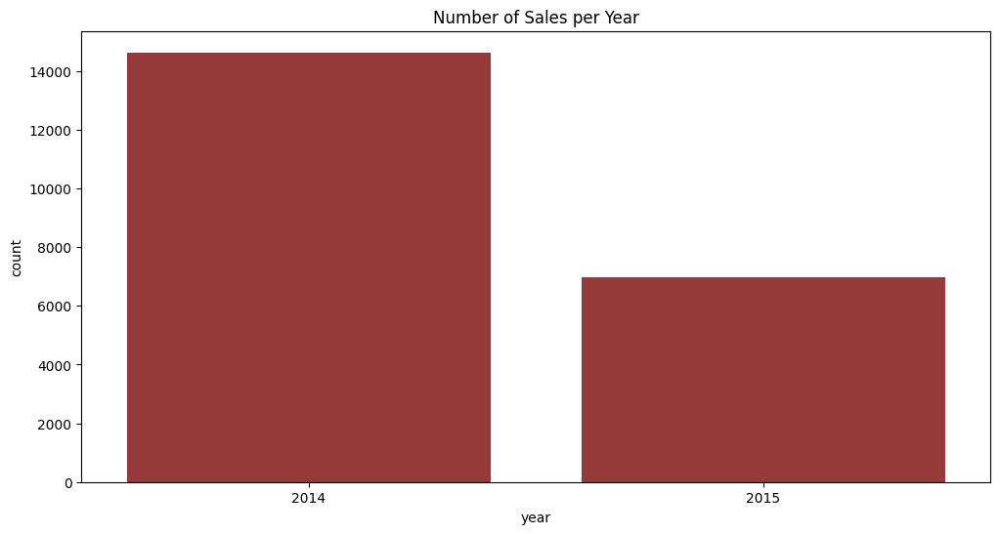

In [161]:
#Number of sales per year
plt.figure(figsize=(12, 6))
sns.countplot(x='year', data=df, color='brown')
plt.title('Number of Sales per Year')
plt.show()

In [162]:
#average price per year
average_price_per_year = df.groupby('year')['price'].mean()
print(average_price_per_year)


year
2014    539181.428415
2015    541988.992264
Name: price, dtype: float64


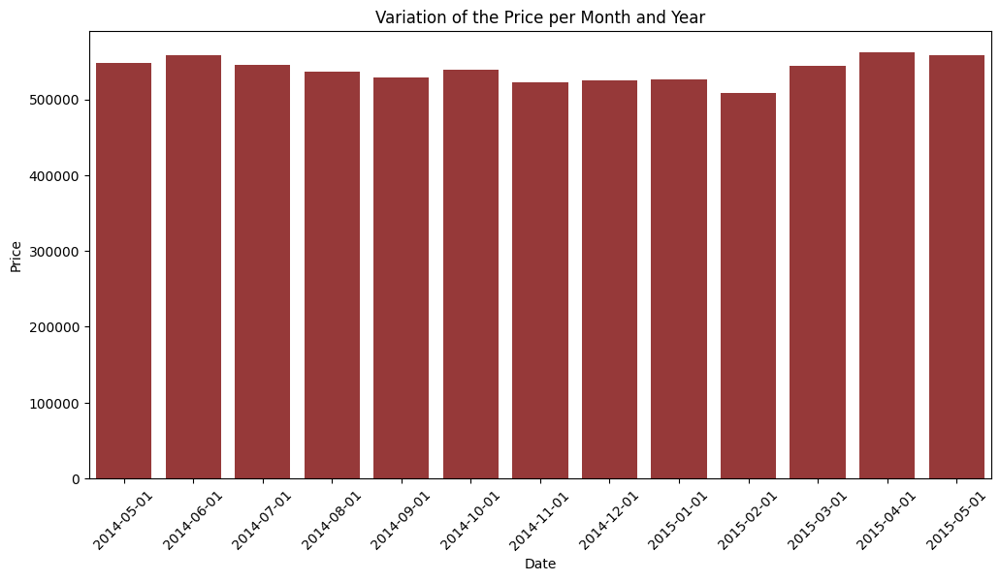

In [163]:
#variation of the price per month and year
avg_price_per_month = df.groupby(['year', 'month'])['price'].mean().reset_index()

avg_price_per_month['date'] = pd.to_datetime(avg_price_per_month[['year', 'month']].assign(day=1))
avg_price_per_month = avg_price_per_month.sort_values('date')

plt.figure(figsize=(12, 6))
sns.barplot(x='date', y='price', data=avg_price_per_month, color='brown')
plt.title('Variation of the Price per Month and Year')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [164]:
#Remove date year and month columns
df = df.drop(['year', 'month'], axis=1)
df = df.drop(['date'], axis=1)

In [165]:
print(df.head())
print(df.shape)

      price  bedrooms  bathrooms  sqft_living  sqft_lot  floors  waterfront  \
0  221900.0         3       1.00         1180      5650     1.0           0   
1  538000.0         3       2.25         2570      7242     2.0           0   
2  180000.0         2       1.00          770     10000     1.0           0   
3  604000.0         4       3.00         1960      5000     1.0           0   
4  510000.0         3       2.00         1680      8080     1.0           0   

   view  condition  grade  sqft_above  sqft_basement  yr_built  yr_renovated  \
0     0          3      7        1180              0      1955             0   
1     0          3      7        2170            400      1951          1991   
2     0          3      6         770              0      1933             0   
3     0          5      7        1050            910      1965             0   
4     0          3      8        1680              0      1987             0   

       lat     long  sqft_living15  sqft_lot

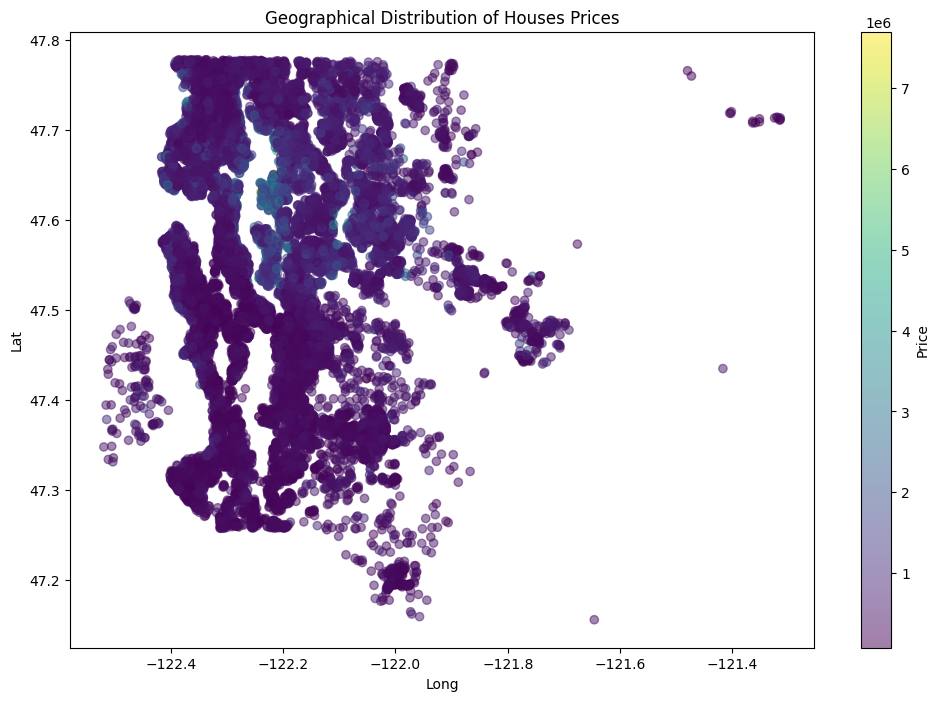

In [166]:
#Geo analysis
plt.figure(figsize=(12, 8))
plt.scatter(df['long'], df['lat'], alpha=0.5, c=df['price'], cmap='viridis')
plt.colorbar(label='Price')
plt.title('Geographical Distribution of Houses Prices')
plt.xlabel('Long')
plt.ylabel('Lat')
plt.show()

In [167]:
#Map visualization
m = folium.Map(location=[df['lat'].mean(), df['long'].mean()], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)

for index, row in df.iterrows():
    folium.Marker(location=[row['lat'], row['long']], popup=f"Price: ${row['price']:,}",icon=folium.Icon(color='blue')).add_to(marker_cluster)

m

In [168]:
#yr_renovated analysis
renovations_per_year = df['yr_renovated'].value_counts().sort_index()
print(renovations_per_year)

yr_renovated
0       20699
1934        1
1940        2
1944        1
1945        3
        ...  
2011       13
2012       11
2013       37
2014       91
2015       16
Name: count, Length: 70, dtype: int64


In [169]:
#group the years renovated into decades
df['yr_renovated'] = df['yr_renovated'].apply(lambda x: x if x == 0 else (x - x%10))

renovations_per_decade = df['yr_renovated'].value_counts().sort_index()
print(renovations_per_decade)

yr_renovated
0       20699
1930        1
1940        9
1950       22
1960       34
1970       56
1980      152
1990      182
2000      272
2010      186
Name: count, dtype: int64


In [170]:
#Check correlation between yr_renovated and price
correlation_yr_renovated = df['yr_renovated'].corr(df['price'])
print(correlation_yr_renovated)

0.12643811121249102


In [171]:
#Manage yr_renovated column with one hot encoding
df = pd.get_dummies(df, columns=['yr_renovated'], drop_first=True)

print(df.head())

      price  bedrooms  bathrooms  sqft_living  sqft_lot  floors  waterfront  \
0  221900.0         3       1.00         1180      5650     1.0           0   
1  538000.0         3       2.25         2570      7242     2.0           0   
2  180000.0         2       1.00          770     10000     1.0           0   
3  604000.0         4       3.00         1960      5000     1.0           0   
4  510000.0         3       2.00         1680      8080     1.0           0   

   view  condition  grade  ...  sqft_lot15  yr_renovated_1930  \
0     0          3      7  ...        5650              False   
1     0          3      7  ...        7639              False   
2     0          3      6  ...        8062              False   
3     0          5      7  ...        5000              False   
4     0          3      8  ...        7503              False   

   yr_renovated_1940  yr_renovated_1950  yr_renovated_1960  yr_renovated_1970  \
0              False              False              

In [172]:
#Save the cleaned data
df.to_csv('cleaned_data.csv', index=False)